# Libraries import

In [ ]:
from langchain.text_splitter import CharacterTextSplitter
# from langchain.embeddings.openai import OpenAIEmbeddings
from langchain.vectorstores.faiss import FAISS
from langchain.chains.question_answering import load_qa_chain
from langchain.llms import OpenAI
from langchain.callbacks import get_openai_callback
from PyPDF2 import PdfReader
from langchain_ollama.embeddings import OllamaEmbeddings
from langchain_community.llms import Ollama
from langchain.chains import RetrievalQA
from langchain.callbacks.manager import CallbackManager
from langchain.callbacks.streaming_stdout import StreamingStdOutCallbackHandler

# Setup and PDF Text Extraction

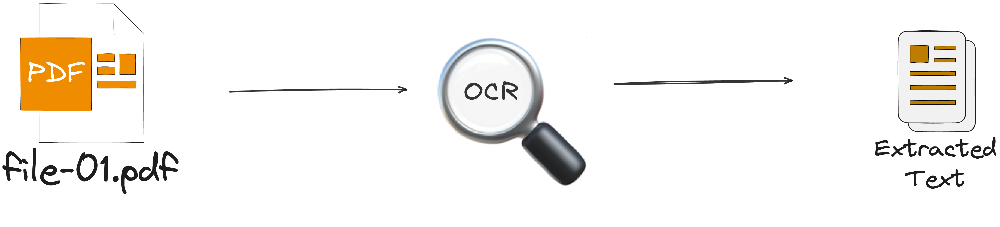

In [58]:
from IPython.display import Image, display
Image(filename= 'img/pdf_to_text_extraction.png', width=800, height=400)  

## Objective
This section illustrates the process of extracting raw text from a PDF document which is a foundational step in any document processing pipeline. Text extraction enables downstream tasks such as semantic analysis, question answering, or indexing for search systems, by converting PDF content into a machine-readable format.



## Key Components

`PyPDF2.PdfReader`: A Python library designed for reading and parsing PDF files. It allows page-by-page access to PDF content, making it suitable for extracting text, metadata, or other document elements.

`.extract_text()`: A method of PyPDF2.PdfReader that retrieves text content from individual PDF pages. It processes the text encoded within the PDF, though results may vary based on the PDF's structure and formatting.



## Additional components

`PDF Complexity`: PDFs store text in complex formats, often embedding fonts, layouts, or graphical elements that can complicate extraction. The accuracy of .extract_text() depends on how the PDF was generated (e.g., text-based vs. scanned documents).

`Limitations of Text Extraction`: For scanned PDFs or those with non-standard encodings, .extract_text() may fail to capture content accurately. In such cases, Optical Character Recognition (OCR) tools like pytesseract or pdf2pic are recommended to convert images to text.

`Verification`: Always inspect the extracted text to ensure quality. Printing a sample (e.g., text[:1000]) helps identify issues like missing characters, formatting artifacts, or incomplete extraction.

`Preprocessing Needs`: Extracted text often requires cleaning (e.g., removing extra newlines, special characters, or headers/footers) before use in NLP pipelines.



In [ ]:
import os
from PyPDF2 import PdfReader
from langchain.text_splitter import CharacterTextSplitter

# Define PDF path
path_to_pdf = "/Users/rockefeller/Documents/Year_25/Learnings/omni_verse/chat_systems/langchain-ask-pdf/Improvements_for_Scalability.pdf"

# Verify file existence
if not os.path.exists(path_to_pdf):
    raise FileNotFoundError(f"PDF file not found at: {path_to_pdf}")

try:
    # Extract text from PDF
    pdf_reader = PdfReader(path_to_pdf)
    text = ""
    for page_num, page in enumerate(pdf_reader.pages, 1):
        page_text = page.extract_text() or ""
        text += page_text
        print(f"Extracted {len(page_text)} characters from page {page_num}")

    # Log total extraction
    print(f"Extracted {len(text)} characters from the PDF")

except Exception as e:
    print(f"Error processing PDF: {str(e)}")

Extracted 1739 characters from page 1
Extracted 1518 characters from page 2
Extracted 1340 characters from page 3
Extracted 224 characters from page 4
Extracted 4821 characters from the PDF


# Text Splitting for Document Processing



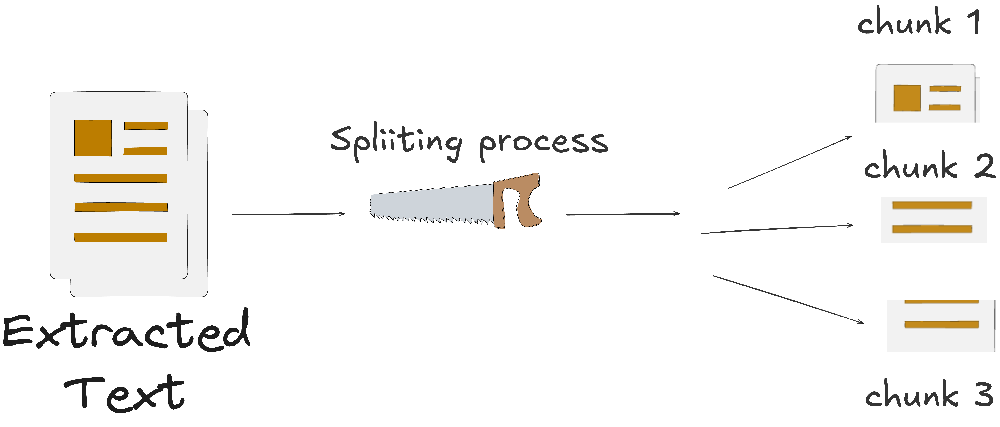

In [59]:
from IPython.display import Image, display
Image(filename= 'img/splitting_process.png', width=800, height=400)  

## Objective
This section explores text splitting, a critical step in preparing large documents for processing by Large Language Models (LLMs) or retrieval-augmented generation (RAG) systems. Splitting text into manageable chunks ensures compatibility with LLMs' limited context windows while preserving semantic coherence for tasks like question answering or semantic search.



## Why Chunking Matters

* Context Window Limitations: LLMs have finite context windows (e.g., 4096 tokens for some models). Documents exceeding this limit must be split into smaller segments to fit within the model's processing capacity.

* Semantic Coherence: Effective chunking maintains the meaning and context within each chunk, improving retrieval quality in applications like RAG, where relevant chunks are retrieved based on similarity to a query.

* Performance and Precision: Smaller, well-defined chunks allow for more precise retrieval and reduce noise, while larger chunks may preserve broader context but risk including irrelevant information.

* Applications: Chunking is essential for indexing documents in vector stores (e.g., FAISS), enabling efficient semantic search, summarization, or question answering.



## Key Parameters Explained


* `chunk_size`: Determines the target size of each chunk (e.g., 1000 characters). A balance must be struck: smaller chunks offer precision but may lose context, while larger chunks retain more context but may exceed model limits or include irrelevant text.

* `chunk_overlap`: Specifies the number of characters shared between consecutive chunks (e.g., 200 characters). Overlap prevents loss of context at chunk boundaries, ensuring continuity for sentences or ideas split across chunks.

* `separator`: Defines natural breaking points for splitting (e.g., newlines \n for paragraphs). Choosing appropriate separators aligns chunks with the document's structure, improving coherence.

* `length_function`: Specifies how text length is measured (e.g., Python’s len() for character count). This can be customized (e.g., counting tokens instead of characters) for token-based models.



## Implementation: CharacterTextSplitter
The `CharacterTextSplitter` is a simple, character-based splitting strategy that divides text based on a specified separator and target chunk size. Below is an enhanced implementation with analysis and error handling.



In [14]:
from langchain.text_splitter import CharacterTextSplitter

# Assume `text` is the extracted text from a PDF (e.g., from PyPDF2)
# Configure text splitting
text_splitter = CharacterTextSplitter(
    separator="\n",         # Split at paragraph boundaries
    chunk_size=300,       # Target ~1000 characters per chunk
    chunk_overlap=200,     # 200-character overlap between chunks
    length_function=len    # Measure length with Python's len()
)

try:
    # Execute text splitting
    chunks = text_splitter.split_text(text)

    # Analysis
    print(f"Split {len(text)} characters into {len(chunks)} chunks")
    print(f"Average chunk size: {sum(len(chunk) for chunk in chunks) / len(chunks):.1f} characters")
    print("\nSample chunk (first 300 characters):")
    print(chunks[0][:300] + "..." if len(chunks[0]) > 300 else chunks[0])

except Exception as e:
    print(f"Error during text splitting: {str(e)}")

Split 4821 characters into 1 chunks
Average chunk size: 4818.0 characters

Sample chunk (first 300 characters):
Improvements	for	Scalability,	Performance,	and	Production	Readiness		Below	are	suggested	improvements	categorized	to	help	scale	this	code	for	production	deployment:	 Code	Modularity	&	Readability		1.	Refactor	into	Modular	Components:		•	Separate	concerns	like	PDF	splitting,	markdown	conversion,	and	...


## Alternative Chunking Strategy: `RecursiveCharacterTextSplitter`

The `RecursiveCharacterTextSplitter` is a more sophisticated method that recursively splits text using a hierarchy of separators (e.g., paragraphs, sentences, words) to create semantically coherent chunks. This is particularly useful for documents with varied structures.


In [20]:
from langchain.text_splitter import RecursiveCharacterTextSplitter

# Configure recursive splitting
recursive_splitter = RecursiveCharacterTextSplitter(
    separators=["\n\n", "\n", ". ", " ", ""],  # Hierarchy: paragraphs, lines, sentences, words
    chunk_size=1000,                          # Target ~1000 characters
    chunk_overlap=200,                        # 200-character overlap
    length_function=len
)

try:
    # Execute recursive splitting
    recursive_chunks = recursive_splitter.split_text(text)

    # Analysis
    print(f"\nRecursiveCharacterTextSplitter Results:")
    print(f"Split {len(text)} characters into {len(recursive_chunks)} chunks")
    print(f"Average chunk size: {sum(len(chunk) for chunk in recursive_chunks) / len(recursive_chunks):.1f} characters")
    print("\nSample chunk (first 300 characters):")
    print(recursive_chunks[0][:300] + "..." if len(recursive_chunks[0]) > 300 else recursive_chunks[0])

except Exception as e:
    print(f"Error during recursive splitting: {str(e)}")


RecursiveCharacterTextSplitter Results:
Split 4821 characters into 6 chunks
Average chunk size: 801.3 characters

Sample chunk (first 300 characters):
Improvements	for	Scalability,	Performance,	and	Production	Readiness		Below	are	suggested	improvements	categorized	to	help	scale	this	code	for	production	deployment:	 Code	Modularity	&	Readability		1.	Refactor	into	Modular	Components:		•	Separate	concerns	like	PDF	splitting,	markdown	conversion,	and	...


## Alternative Chunking Strategy: `SemanticChunker`



The SemanticChunker  splits text based on semantic similarity, using embeddings to group related sentences into chunks. This ensures chunks are semantically coherent, improving retrieval quality for RAG systems.

In [24]:
from langchain_experimental.text_splitter import SemanticChunker
from langchain_ollama import OllamaEmbeddings

# Configure semantic chunking
semantic_splitter = SemanticChunker(
    embeddings=OllamaEmbeddings(model="nomic-embed-text:latest"),
    breakpoint_threshold_type="percentile",  # Split at significant semantic shifts
    breakpoint_threshold_amount=85          # 85th percentile for semantic difference
)

try:
    # Execute semantic splitting
    semantic_chunks = semantic_splitter.split_text(text)

    # Analysis
    print(f"\nSemanticChunker Results:")
    print(f"Split {len(text)} characters into {len(semantic_chunks)} chunks")
    print(f"Average chunk size: {sum(len(chunk) for chunk in semantic_chunks) / len(semantic_chunks):.1f} characters")
    print("\nSample chunk (first 300 characters):")
    print(semantic_chunks[0][:300] + "..." if len(semantic_chunks[0]) > 300 else semantic_chunks[0])

except Exception as e:
    print(f"Error during semantic splitting: {str(e)}")


SemanticChunker Results:
Split 4821 characters into 11 chunks
Average chunk size: 433.9 characters

Sample chunk (first 300 characters):
Improvements	for	Scalability,	Performance,	and	Production	Readiness		Below	are	suggested	improvements	categorized	to	help	scale	this	code	for	production	deployment:	 Code	Modularity	&	Readability		1. Refactor	into	Modular	Components:		•	Separate	concerns	like	PDF	splitting,	markdown	conversion,	and	...


# Embeddings Generation

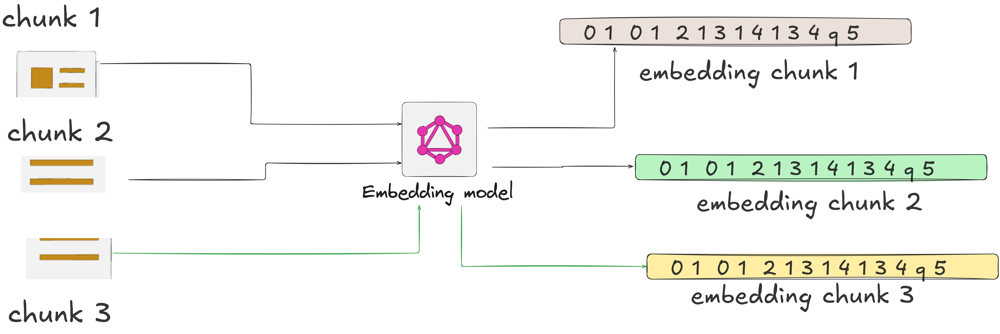

In [60]:
from IPython.display import Image, display
Image(filename= 'img/embeddings_generation.png', width=800, height=400)  

## Objective
This section demonstrates how to generate text embeddings, transforming textual data into fixed-length numerical vectors that capture semantic meaning. Embeddings are essential for tasks like semantic search, clustering, classification, and retrieval-augmented generation (RAG) in natural language processing (NLP) pipelines.



## Key Concepts

`Text to Numerical Vectors`: Embeddings convert text (e.g., words, phrases, or documents) into fixed-length numerical vectors in a high-dimensional space (e.g., 384 or 768 dimensions). These vectors represent the text’s semantic content in a machine-readable format.

`Semantic Encoding`: The geometric arrangement of vectors in the embedding space encodes semantic meaning. Similar texts (e.g., "database scaling techniques" and "how to make databases faster") have vectors that are closer together, as measured by metrics like cosine similarity.

`Cosine Similarity`: A metric to quantify the similarity between two vectors, calculated as the cosine of the angle between them. Values range from -1 (opposite meaning) to 1 (identical meaning), with higher values indicating greater semantic similarity.

`Applications`: Embeddings power semantic search, document retrieval, question answering, and clustering by enabling machines to compare and understand text based on meaning rather than exact string matches.



## Model Choices

* `nomic-embed-text`: An open-weight embedding model optimized for general-purpose text processing. It provides robust performance for tasks like semantic search and clustering, with the advantage of being freely accessible and locally runnable via Ollama.

* Alternatives:
OpenAI's text-embedding-3-small: A compact, high-performance model from OpenAI, ideal for applications requiring efficiency and accuracy. Requires an API key and internet access.

* `snowflake-arctic-embed2:latest`: state-of-the-art multilingual text embedding model optimized for high-quality retrieval performance and inference efficiencystate-of-the-art multilingual text embedding model optimized for high-quality retrieval performance and inference efficiency

* `Considerations`: Choose a model based on task requirements (e.g., monolingual vs. multilingual), computational resources, and whether open-source or proprietary solutions are preferred. Local models like nomic-embed-text avoid API costs but require sufficient hardware.



In [29]:
import numpy as np
from langchain_ollama import OllamaEmbeddings
from sklearn.metrics.pairwise import cosine_similarity
from typing import List, Optional

# Initialize embedding models
try:
    ollama_nomic_embeddings = OllamaEmbeddings(model="nomic-embed-text:latest")
    ollama_mxbai_embeddings = OllamaEmbeddings(model="mxbai-embed-large:latest")  # Alternative model
except Exception as e:
    print(f"Error initializing embedding models: {str(e)}")
    exit(1)

# Sample phrases for demonstration
sample_phrases = [
    "database scaling techniques",
    "how to make databases faster",
    "nutritional value of apples"
]

def compute_embeddings(phrases: List[str], embedder, model_name: str) -> Optional[List[List[float]]]:
    """Compute embeddings for a list of phrases."""
    try:
        vectors = [embedder.embed_query(phrase) for phrase in phrases]
        return vectors
    except Exception as e:
        print(f"Error computing {model_name} embeddings: {str(e)}")
        return None


# Generate embeddings for both models
nomic_vectors = compute_embeddings(sample_phrases, ollama_nomic_embeddings, "nomic")
mxbai_vectors = compute_embeddings(sample_phrases, ollama_mxbai_embeddings, "mxbai")



In [ ]:
mxbai_vectors

3

In [34]:
# Analysis function
def analyze_embeddings(vectors: List[List[float]], model_name: str, phrases: List[str]):
    if not vectors:
        print(f"No embeddings generated for {model_name}")
        return
    
    # Normalize vectors for cosine similarity
    normalized_vectors = np.array(vectors) / np.linalg.norm(vectors, axis=1, keepdims=True)
    
    # Compute cosine similarities
    similar_sim = cosine_similarity([normalized_vectors[0]], [normalized_vectors[1]])[0][0]
    dissimilar_sim = cosine_similarity([normalized_vectors[0]], [normalized_vectors[2]])[0][0]
    
    # Output properties
    print(f"\n{model_name} Embeddings:")
    print(f"  - Embedding dimension: {len(vectors[0])}")
    print(f"  - Similarity between '{phrases[0]}' and '{phrases[1]}': {similar_sim:.3f}")
    print(f"  - Similarity between '{phrases[0]}' and '{phrases[2]}': {dissimilar_sim:.3f}")
    print(f"  - Sample embedding (first 5 dimensions for '{phrases[0]}'):")
    print(vectors[0][:5])

# Analyze embeddings for both models
analyze_embeddings(nomic_vectors, "nomic-embed-text", sample_phrases)
print("\n" + "="*50 + "\n")
analyze_embeddings(mxbai_vectors, "mxbai-embed-large", sample_phrases)


nomic-embed-text Embeddings:
  - Embedding dimension: 768
  - Similarity between 'database scaling techniques' and 'how to make databases faster': 0.653
  - Similarity between 'database scaling techniques' and 'nutritional value of apples': 0.376
  - Sample embedding (first 5 dimensions for 'database scaling techniques'):
[0.06204268, 0.10056231, -0.18387571, -0.05794226, 0.0043323203]



mxbai-embed-large Embeddings:
  - Embedding dimension: 1024
  - Similarity between 'database scaling techniques' and 'how to make databases faster': 0.749
  - Similarity between 'database scaling techniques' and 'nutritional value of apples': 0.307
  - Sample embedding (first 5 dimensions for 'database scaling techniques'):
[-0.001633542, 0.020176804, 0.024866132, -0.010655367, 0.0029946798]


# Vector Stores and Similarity Search



In [61]:
from IPython.display import Image, display
Image(filename= 'img/vector_store.png', width=800, height=400)  

## Objective
This section demonstrates how to create a vector store using FAISS (Facebook AI Similarity Search) to index text embeddings and perform efficient similarity searches. Vector stores are critical for retrieval-augmented generation (RAG) systems, enabling fast and accurate retrieval of relevant document chunks based on a query's semantic content.



## Key Concepts
- `Vector Stores`: Databases designed to store and index high-dimensional embeddings, allowing for efficient similarity searches. They map text chunks to their corresponding embeddings, enabling retrieval of documents that are semantically similar to a query.

- `FAISS`: A high-performance library developed by Facebook AI for similarity search and clustering of dense vectors. It is optimized for large-scale datasets and supports fast nearest-neighbor searches using cosine similarity or other metrics.

- `Similarity Search`: Retrieves the top-k most similar documents to a query based on their embedding vectors, typically using cosine similarity. This is ideal for tasks like question answering or semantic search.

- `Retrieval Parameters:`

    * `k`: The number of top documents (chunks) to retrieve. A higher k returns more results but may include less relevant documents.

    * `search_type`: Determines the retrieval method:
"similarity": Ranks documents by cosine similarity to the query embedding (default).

    * `"mmr"`: Maximum Marginal Relevance, which balances similarity and diversity to avoid redundant results.

`Applications:` Vector stores are foundational for RAG pipelines, enabling systems to retrieve relevant context from large document sets for tasks like question answering, summarization, or chatbot responses.





In [36]:
import numpy as np
from langchain.vectorstores.faiss import FAISS
from langchain_ollama import OllamaEmbeddings
from typing import List

# Initialize embedding model (assumes model is available)
try:
    embeddings = OllamaEmbeddings(model="nomic-embed-text:latest")
except Exception as e:
    print(f"Error initializing embeddings: {str(e)}")
    exit(1)

# Assume `chunks` is a list of text chunks from previous text splitting
# Create vector store
try:
    knowledge_base = FAISS.from_texts(chunks, embeddings)
    print(f"Created FAISS vector store with {len(chunks)} documents")
except Exception as e:
    print(f"Error creating FAISS vector store: {str(e)}")
    exit(1)


Created FAISS vector store with 1 documents


In [38]:

# Function to perform and display retrieval results
def perform_retrieval(knowledge_base, query: str, k: int = 2, search_type: str = "similarity") -> None:
    """Perform similarity search or MMR and display results."""
    try:
        if search_type == "mmr":
            docs = knowledge_base.max_marginal_relevance_search(query, k=k, fetch_k=10)
        else:
            docs = knowledge_base.similarity_search(query, k=k)
        
        print(f"\nTop {k} matching chunks (search_type: {search_type}):")
        for i, doc in enumerate(docs, 1):
            content = doc.page_content[:200] + "..." if len(doc.page_content) > 200 else doc.page_content
            print(f"\nMATCH {i}:")
            print(content)
            # Optionally display similarity score
            query_embedding = embeddings.embed_query(query)
            doc_embedding = embeddings.embed_documents([doc.page_content])[0]
            similarity = np.dot(query_embedding, doc_embedding) / (
                np.linalg.norm(query_embedding) * np.linalg.norm(doc_embedding)
            )
            print(f"Similarity score: {similarity:.3f}")

    except Exception as e:
        print(f"Error during {search_type} retrieval: {str(e)}")

# Test retrieval with different parameters
query = "methods to improve system scalability"
print(f"\nQuery: {query}")

# Similarity search with k=2
perform_retrieval(knowledge_base, query, k=2, search_type="similarity")




Query: methods to improve system scalability

Top 2 matching chunks (search_type: similarity):

MATCH 1:
Improvements	for	Scalability,	Performance,	and	Production	Readiness		Below	are	suggested	improvements	categorized	to	help	scale	this	code	for	production	deployment:	 Code	Modularity	&	Readability		1.	...
Similarity score: 0.365


In [39]:
# Similarity search with k=3
perform_retrieval(knowledge_base, query, k=3, search_type="similarity")



Top 3 matching chunks (search_type: similarity):

MATCH 1:
Improvements	for	Scalability,	Performance,	and	Production	Readiness		Below	are	suggested	improvements	categorized	to	help	scale	this	code	for	production	deployment:	 Code	Modularity	&	Readability		1.	...
Similarity score: 0.365


In [40]:

# MMR search with k=2
perform_retrieval(knowledge_base, query, k=2, search_type="mmr")


Top 2 matching chunks (search_type: mmr):

MATCH 1:
Improvements	for	Scalability,	Performance,	and	Production	Readiness		Below	are	suggested	improvements	categorized	to	help	scale	this	code	for	production	deployment:	 Code	Modularity	&	Readability		1.	...
Similarity score: 0.365


# LLM Call Setup for Text Generation



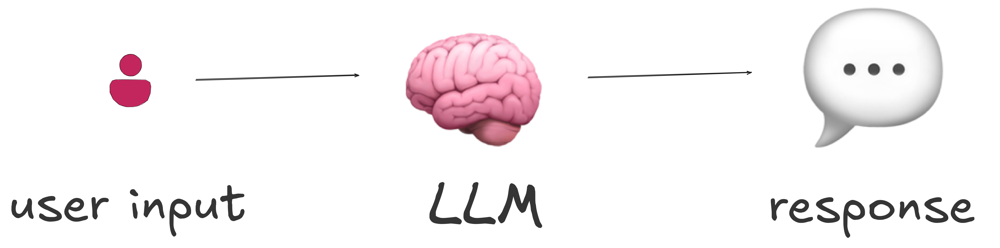

In [63]:
from IPython.display import Image, display
Image(filename= 'img/llm_call.png', width=800, height=400)  

## Objective
This section demonstrates how to configure and invoke a Large Language Model (LLM) using the Ollama framework to generate human-like text responses. LLMs are essential for tasks like question answering, summarization, and conversational systems, particularly when integrated with retrieval-augmented generation (RAG) pipelines.



## Key Concepts
* Large Language Models (LLMs): Neural network models trained on vast text datasets to generate coherent and contextually relevant responses. They excel at understanding and generating natural language for tasks like answering questions or explaining concepts.

* Ollama Framework: A platform for running open-source LLMs locally, providing control over model hosting and avoiding API costs. It supports models like LLaMA, Mistral, and Gemma.

* Configuration Parameters:

    - `temperature`: Controls the randomness of the output. Lower values (e.g., 0–0.3) produce factual, deterministic responses, while higher values (e.g., 0.7–1.0) encourage creativity and diversity.

    - `top_p`: Implements nucleus sampling, where only the smallest set of tokens with cumulative probability above top_p is considered. Lower values (e.g., 0.9) focus on likely tokens, while higher values allow more diversity.

* Applications: LLMs power chatbots, content generation, and RAG systems by generating responses based on retrieved context or standalone prompts.



## Model Choices

* `llama3.1`: A high-performing open-source model from Meta AI, offering a good balance of speed, accuracy, and resource efficiency. Suitable for general-purpose tasks like question answering and text generation.


* Alternatives:
    - Mistral: A lightweight, efficient model optimized for tasks requiring fast inference and high-quality responses. Available via Ollama.

    - Gemma: A family of models from Google, designed for research and efficient NLP tasks, also available via Ollama.

    - Closed Models (e.g., GPT-4): Proprietary models from OpenAI or other providers, offering state-of-the-art performance but requiring API access and incurring costs.

* Considerations: Open-source models like llama3.1 are ideal for local deployment and privacy but require sufficient hardware (e.g., GPU for faster inference). Closed models are easier to use via APIs but may involve latency and cost trade-offs.



In [45]:
# from langchain_community.llms import Ollama
from langchain_ollama import OllamaLLM
from typing import Optional

# Function to initialize and test LLM
def initialize_and_test_llm(model_name: str, temperature: float = 0.3, top_p: float = 0.9) -> Optional[Ollama]:
    """Initialize LLM and test with a prompt."""
    try:
        llm = OllamaLLM(
            model=model_name,
            temperature=temperature,
            top_p=top_p,
            callback_manager=None  # Optional: Add callbacks for streaming if needed
        )
        return llm
    except Exception as e:
        print(f"Error initializing {model_name}: {str(e)}")
        return None


In [46]:
# Test generation function
def test_llm_generation(llm: Ollama, prompt: str, model_name: str) -> None:
    """Test LLM with a given prompt and display response."""
    try:
        response = llm(prompt)
        print(f"\n{model_name} Response (temperature={llm.temperature}, top_p={llm.top_p}):")
        print(response)
        print(f"Response length: {len(response)} characters")
    except Exception as e:
        print(f"Error generating response with {model_name}: {str(e)}")


In [47]:
# Test configurations
prompt = "Explain vector databases to a 10-year-old:"
models = [
    {"name": "llama3.1:latest", "temperature": 0.3, "top_p": 0.9},
    {"name": "llama3.1:latest", "temperature": 0.7, "top_p": 0.9},  # Higher temperature for creativity
    {"name": "mistral:latest", "temperature": 0.3, "top_p": 0.9}   # Alternative model
]

In [48]:

# Run tests
for config in models:
    llm = initialize_and_test_llm(
        model_name=config["name"],
        temperature=config["temperature"],
        top_p=config["top_p"]
    )
    if llm:
        test_llm_generation(llm, prompt, config["name"])
        print("\n" + "="*50 + "\n")


llama3.1:latest Response (temperature=0.3, top_p=0.9):
Imagine you have a huge box of toys, and each toy has lots of information about it, like its name, color, shape, and who gave it to you. A regular database would be like a big piece of paper where you write down all the information about each toy.

But what if you wanted to find all the red balls in your box? Or all the toys that were given to you by your grandma? That's where vector databases come in!

A vector database is like a super-smart librarian who helps you find things quickly and easily. It uses special math tools called "vectors" to understand what makes each toy unique.

Think of vectors like secret codes that describe each toy. For example, the code for your red ball might be: "red + round + bouncy". The vector database can then use these codes to find all the toys that match certain qualities, like all the red balls or all the toys that are both round and bouncy.

Here's how it works:

1. You give each toy a special 

I don't have information about future events, including sports championships. My training data only goes up to 2021, and I don't have the ability to predict or know the outcomes of future events.

However, if you're looking for information about past championships or want to discuss a specific sport or league, I'd be happy to try and help!


In [64]:
from IPython.display import Image, display
Image(filename= 'img/black_box.png', width=800, height=400)  

In [ ]:
llm = Ollama(model="llama3.1:latest", temperature=0.3)
print(llm("Who won the championship in 2025?"))

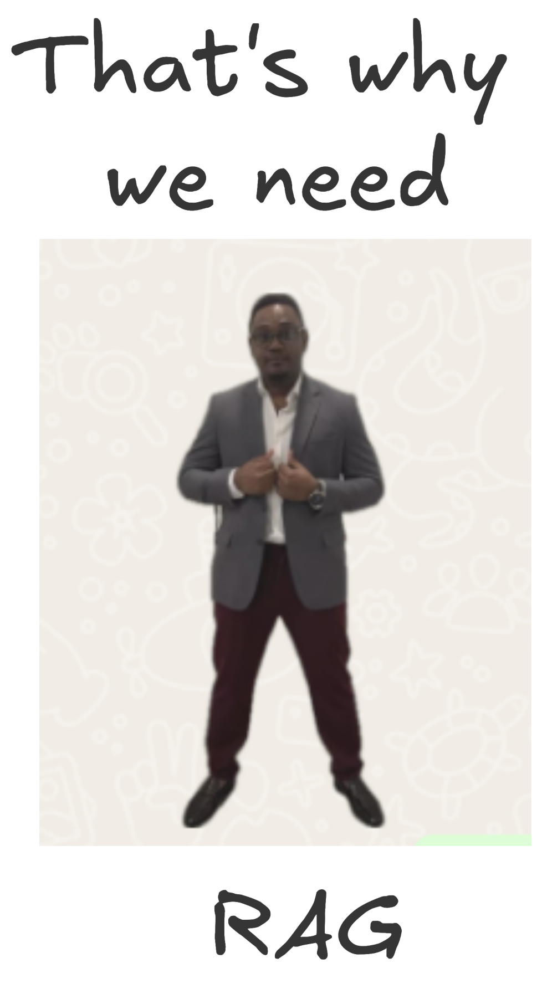

In [56]:
from IPython.display import Image, display
Image(filename= 'img/need_of_RAG.png', width=200, height=400)  